## Overview

This notebook demonstrates how to segment a MIDI file and play its segments using `sf_segmenter` and `pyfluidsynth` in Python. The segmentation process identifies musical patterns and boundaries, which can be adjusted using specific configuration parameters.

### Configuration

The segmentation process relies heavily on the configuration parameters defined for `sf_segmenter`. These parameters determine the sensitivity and resolution of the segmentation, influencing how the musical patterns and boundaries are identified. The key configuration parameters include:

(this we need do double-check with more experiments)
- `M_gaussian`: Smaller Gaussian window for higher resolution.
- `m_embedded`: Reduce embedded dimensions to increase sensitivity.
- `k_nearest`: Smaller k_nearest to increase sensitivity.
- `Mp_adaptive`: Smaller adaptive window for higher resolution.
- `offset_thres`: Lower offset threshold for more boundaries.
- `bound_norm_feats`: Normalization method for boundary features.

These parameters can be adjusted to tailor the segmentation to specific musical patterns and desired outcomes.

### Steps

1. **Install necessary libraries**:
   - Upgrade `pip`, `setuptools`, and `wheel`.
   - Install `ffmpeg` and `libsndfile` using Homebrew.
   - Install Python packages: `sf_segmenter`, `pretty_midi`, `midiutil`, `librosa`, `matplotlib`, `numpy`, and `pyfluidsynth`.

2. **Import libraries and configure environment**:
   - Import necessary libraries and configure `matplotlib` for inline plotting.

3. **Define input and configuration**:
   - Set the input MIDI file path and configuration parameters.

4. **Initialize and process the segmenter**:
   - Initialize `sf_segmenter` and process the MIDI file to extract segments.

5. **Extract and save MIDI segments**:
   - Extract MIDI segments based on boundaries and save them.

6. **Generate and display novelty curve plot**:
   - Generate and display the novelty curve plot using `sf_segmenter`.

7. **Play MIDI files**:
   - Define a function to play MIDI files using `pyfluidsynth`.
   - Play the original MIDI file and up to 5 random MIDI segments.

## import the necessary libraries (sorry, I'm using macOS)

In [ ]:
!pip install --upgrade pip
!pip install --upgrade setuptools wheel
!brew install ffmpeg libsndfile
!brew reinstall ffmpeg
!brew reinstall libsndfile
!pip install sf_segmenter
!pip install librosa miditoolkit pretty_midi matplotlib
!pip install sf_segmenter pretty_midi midiutil matplotlib numpy

In [1]:
import sf_segmenter
import pretty_midi
import matplotlib.pyplot as plt
import numpy as np
import os
import pretty_midi

# configure matplotlib for inline plotting
%matplotlib inline

# define the input MIDI file path and configuration
INPUT_PATH = "Something_in_the_Way.mid"
CONFIG = {
    "M_gaussian": 10,       # smaller Gaussian window for higher resolution
    "m_embedded": 2,        # reduce embedded dimensions to increase sensitivity
    "k_nearest": 0.02,      # smaller k_nearest to increase sensitivity
    "Mp_adaptive": 10,      # smaller adaptive window for higher resolution
    "offset_thres": 0.02,   # lower offset threshold for more boundaries
    "bound_norm_feats": np.inf  # normalization method
}

In [2]:
# initialize the segmenter
segmenter = sf_segmenter.Segmenter(config=CONFIG)

# process the MIDI file to extract segments
segmenter.proc_midi(INPUT_PATH)

# get segment boundaries
segment_boundaries = segmenter.boundaries

 > 0
 > 1
 > 2
 > 3
 > 4
 > 5
 > 6
 > 7
 > 8
 > 9
 > 10
 > 11


In [3]:
# function to extract MIDI segments
def extract_midi_segment(midi_data, start_time, end_time, output_path):
    segment = pretty_midi.PrettyMIDI()
    for instrument in midi_data.instruments:
        new_instrument = pretty_midi.Instrument(
            program=instrument.program,
            is_drum=instrument.is_drum,
            name=instrument.name
        )
        for note in instrument.notes:
            if start_time <= note.start < end_time:
                new_note = pretty_midi.Note(
                    velocity=note.velocity,
                    pitch=note.pitch,
                    start=max(0, note.start - start_time),
                    end=min(note.end - start_time, end_time - start_time)
                )
                new_instrument.notes.append(new_note)
        if new_instrument.notes:
            segment.instruments.append(new_instrument)
    segment.write(output_path)

In [4]:
# load the original MIDI file
midi_data = pretty_midi.PrettyMIDI(INPUT_PATH)

# extract segments based on boundaries
output_dir = 'samples'
os.makedirs(output_dir, exist_ok=True)
for i in range(len(segment_boundaries) - 1):
    start_time = segment_boundaries[i]
    end_time = segment_boundaries[i + 1]
    output_path = f"{output_dir}/segment_{i}.mid"
    extract_midi_segment(midi_data, start_time, end_time, output_path)

 [o] save to ... plots


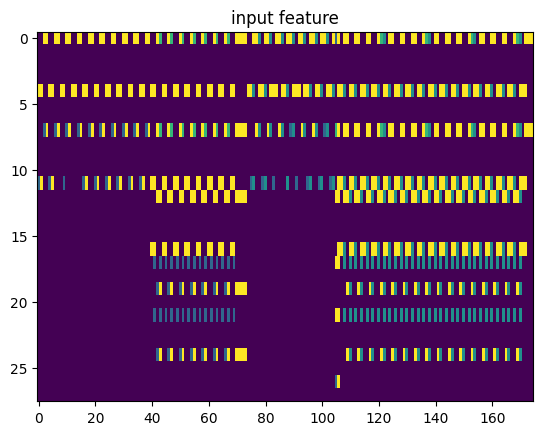

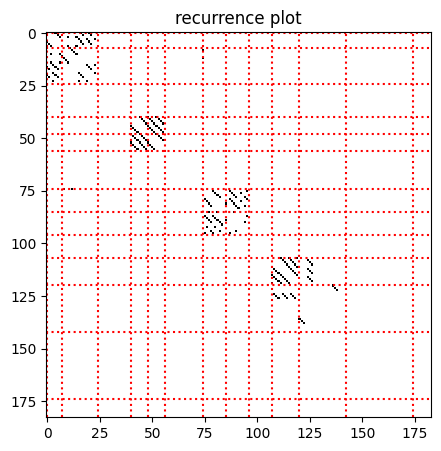

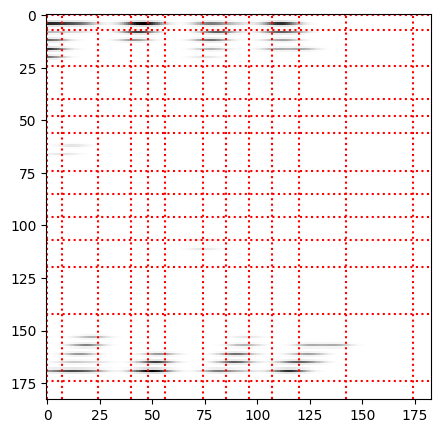

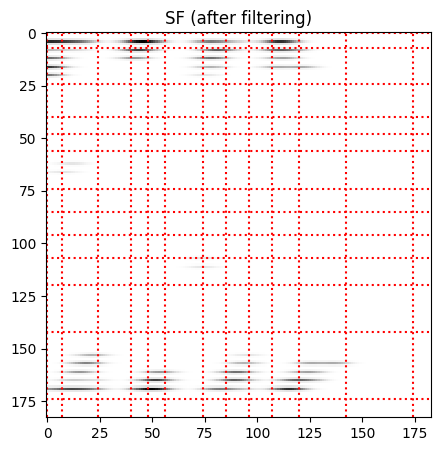

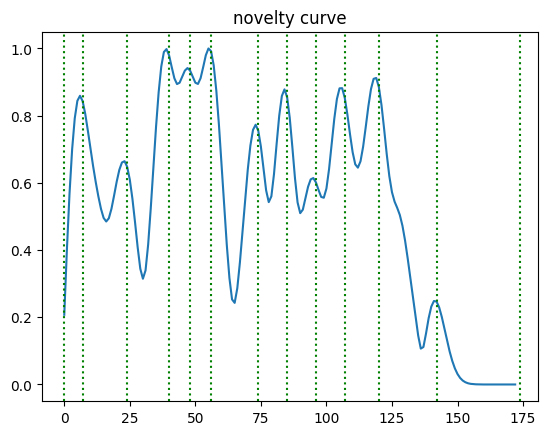

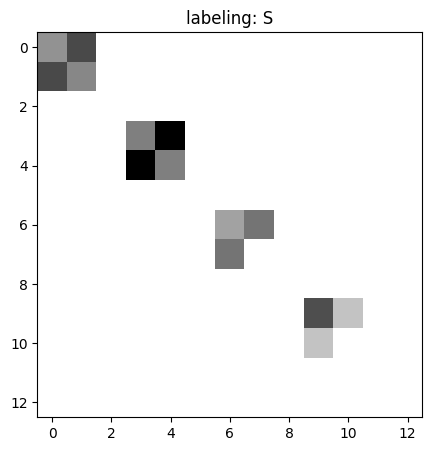

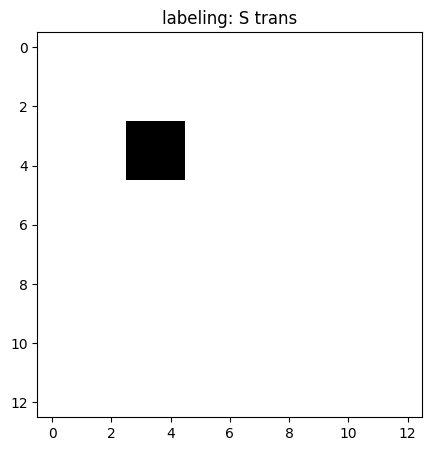

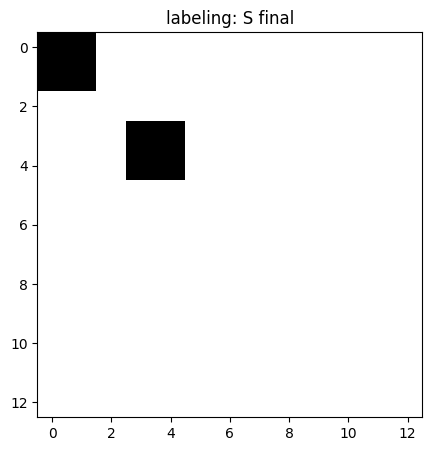

In [5]:
# generate and display the novelty curve plot using sf_segmenter's built-in method
plot_dir = "plots"
os.makedirs(plot_dir, exist_ok=True)
segmenter.plot(plot_dir)

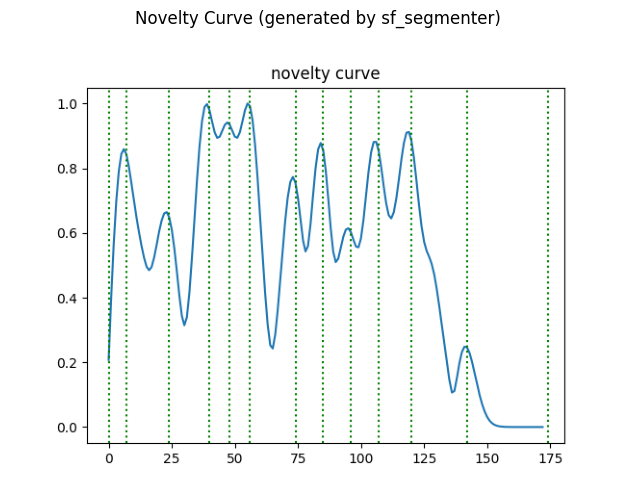

Number of segments: 12
Segment 0: start = 0.00s, end = 7.00s, duration = 7.00s
Segment 1: start = 7.00s, end = 24.00s, duration = 17.00s
Segment 2: start = 24.00s, end = 40.00s, duration = 16.00s
Segment 3: start = 40.00s, end = 48.00s, duration = 8.00s
Segment 4: start = 48.00s, end = 56.00s, duration = 8.00s
Segment 5: start = 56.00s, end = 74.00s, duration = 18.00s
Segment 6: start = 74.00s, end = 85.00s, duration = 11.00s
Segment 7: start = 85.00s, end = 96.00s, duration = 11.00s
Segment 8: start = 96.00s, end = 107.00s, duration = 11.00s
Segment 9: start = 107.00s, end = 120.00s, duration = 13.00s
Segment 10: start = 120.00s, end = 142.00s, duration = 22.00s
Segment 11: start = 142.00s, end = 174.00s, duration = 32.00s


In [8]:
# load and display the generated novelty curve plot
novelty_curve_path = f"{plot_dir}/nc.png"
img = plt.imread(novelty_curve_path)
plt.figure(figsize=(12, 6))
plt.imshow(img)
plt.axis('off')
plt.title('Novelty Curve (generated by sf_segmenter)')
plt.show()

# print segment information
print(f"Number of segments: {len(segment_boundaries) - 1}")
for i, (start, end) in enumerate(zip(segment_boundaries[:-1], segment_boundaries[1:])):
    print(f"Segment {i}: start = {start:.2f}s, end = {end:.2f}s, duration = {end-start:.2f}s")

In [ ]:
!pip install pyfluidsynth

In [18]:
from IPython.display import Audio, display
import pretty_midi
import os
import random

INPUT_PATH = "Something_in_the_Way.mid"
output_dir = 'samples'

# function to play MIDI using pyfluidsynth
def play_midi(midi_path):
    try:
        midi_data = pretty_midi.PrettyMIDI(midi_path)
        audio_data = midi_data.fluidsynth()
        return Audio(audio_data, rate=44100)
    except ImportError:
        print("pyFluidSynth is not installed. Attempting to use pretty_midi's synthesize method.")
        try:
            audio_data = midi_data.synthesize()
            return Audio(audio_data, rate=44100)
        except Exception as e:
            print(f"Error processing MIDI with pretty_midi: {e}")
            print(f"MIDI file available at: {midi_path}")
            return None
    except Exception as e:
        print(f"Error processing MIDI: {e}")
        print(f"MIDI file available at: {midi_path}")
        return None

# play original MIDI
print("Original MIDI:")
audio = play_midi(INPUT_PATH)
if audio:
    display(audio)

# all sample files
sample_files = [f for f in os.listdir(output_dir) if f.endswith('.mid')]

random.shuffle(sample_files)

# up to 5 sample segments in random order
sample_files_to_play = sample_files[:5]
for i, sample_file in enumerate(sample_files_to_play):
    sample_path = os.path.join(output_dir, sample_file)
    print(f"Sample {i}:")
    audio = play_midi(sample_path)
    if audio:
        display(audio)

Original MIDI:


Sample 0:


Sample 1:


Sample 2:


Sample 3:


Sample 4:


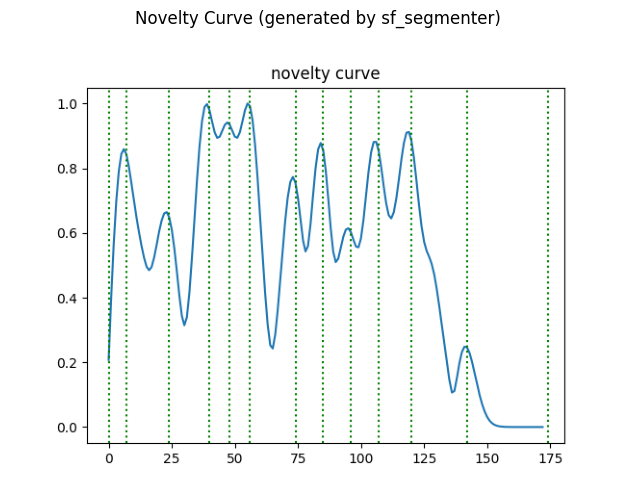

Number of segments: 12
Segment 0: start = 0.00s, end = 7.00s, duration = 7.00s
Segment 1: start = 7.00s, end = 24.00s, duration = 17.00s
Segment 2: start = 24.00s, end = 40.00s, duration = 16.00s
Segment 3: start = 40.00s, end = 48.00s, duration = 8.00s
Segment 4: start = 48.00s, end = 56.00s, duration = 8.00s
Segment 5: start = 56.00s, end = 74.00s, duration = 18.00s
Segment 6: start = 74.00s, end = 85.00s, duration = 11.00s
Segment 7: start = 85.00s, end = 96.00s, duration = 11.00s
Segment 8: start = 96.00s, end = 107.00s, duration = 11.00s
Segment 9: start = 107.00s, end = 120.00s, duration = 13.00s
Segment 10: start = 120.00s, end = 142.00s, duration = 22.00s
Segment 11: start = 142.00s, end = 174.00s, duration = 32.00s


In [ ]:
# load and display the generated novelty curve plot
novelty_curve_path = f"{plot_dir}/nc.png"
img = plt.imread(novelty_curve_path)
plt.figure(figsize=(12, 6))
plt.imshow(img)
plt.axis('off')
plt.title('Novelty Curve (generated by sf_segmenter)')
plt.show()

# print segment information
print(f"Number of segments: {len(segment_boundaries) - 1}")
for i, (start, end) in enumerate(zip(segment_boundaries[:-1], segment_boundaries[1:])):
    print(f"Segment {i}: start = {start:.2f}s, end = {end:.2f}s, duration = {end-start:.2f}s")

## Conclusion

In this notebook, we segmented a MIDI file and played its segments using `sf_segmenter` and `pyfluidsynth`. The segmentation process used configurable parameters to fine-tune the detection of musical patterns and boundaries. We also generated a novelty curve plot to visualize the segmentation. Finally, we played the original MIDI file and up to 5 random segments directly within the notebook.